<a href="https://colab.research.google.com/github/bardiaHSZD/Algorithms_DataStructure/blob/main/003_CPP_Object_Oriented_Programming.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Term 01 - Week 03**

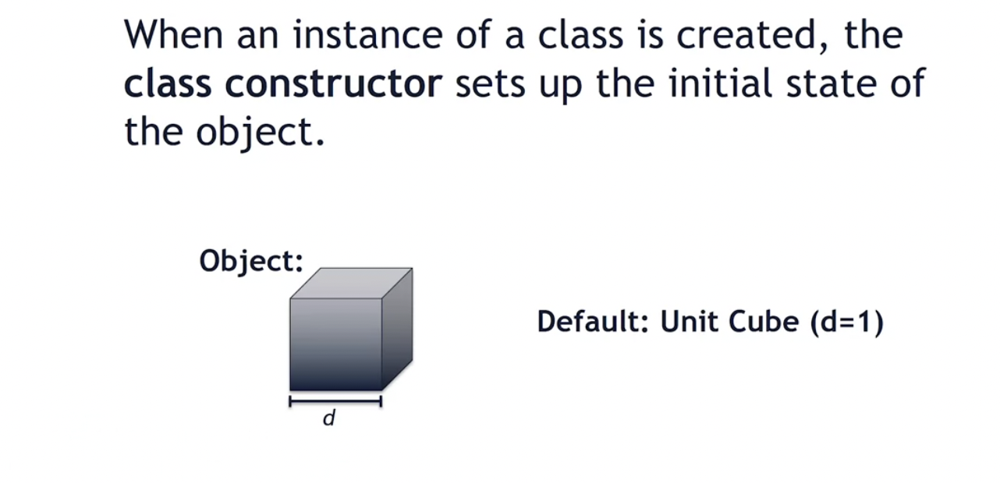

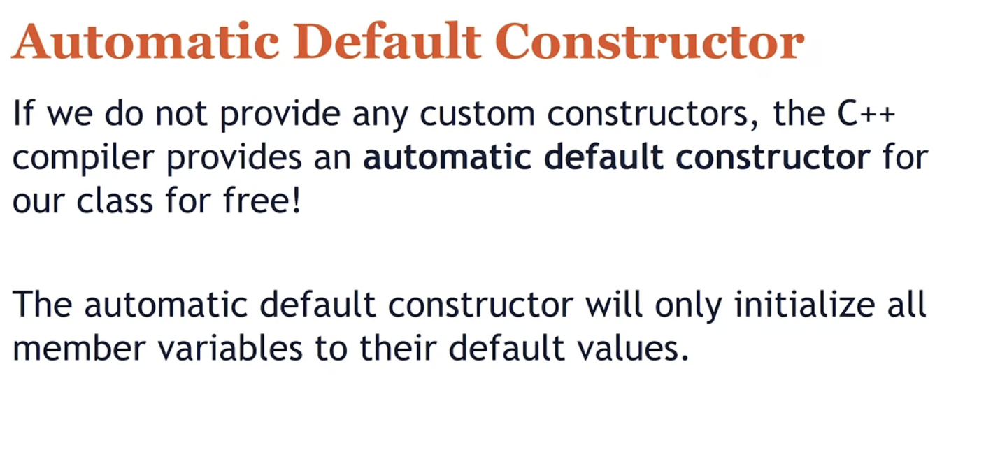

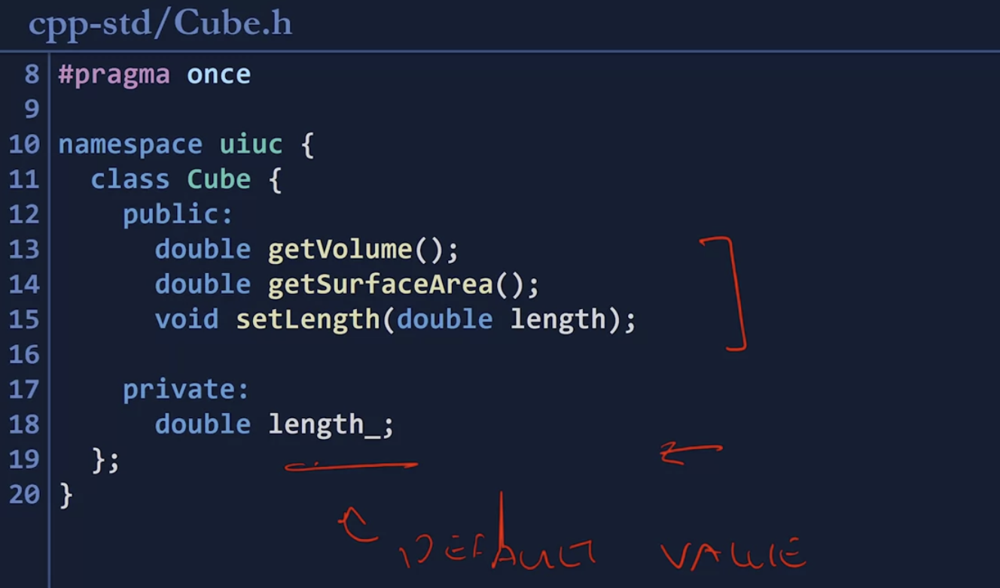

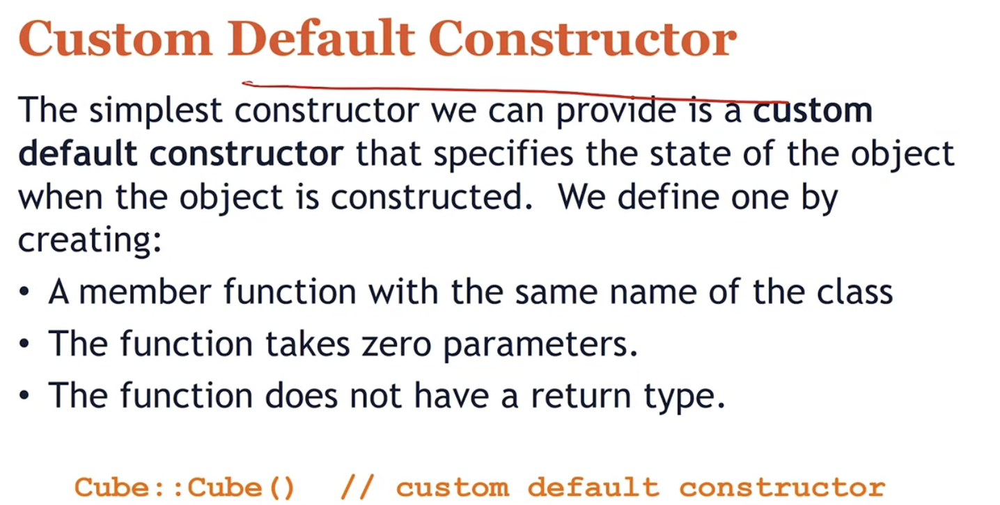

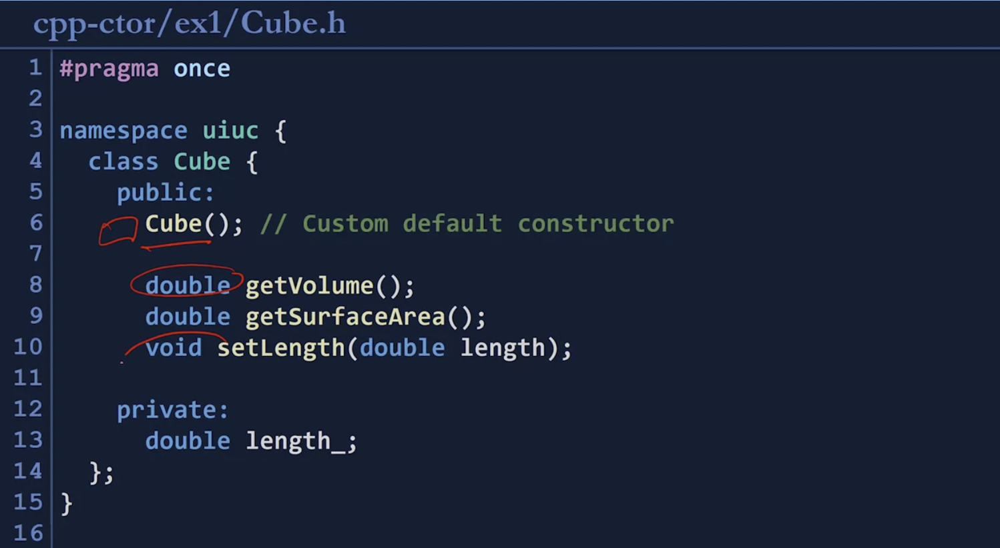

...

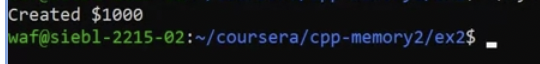

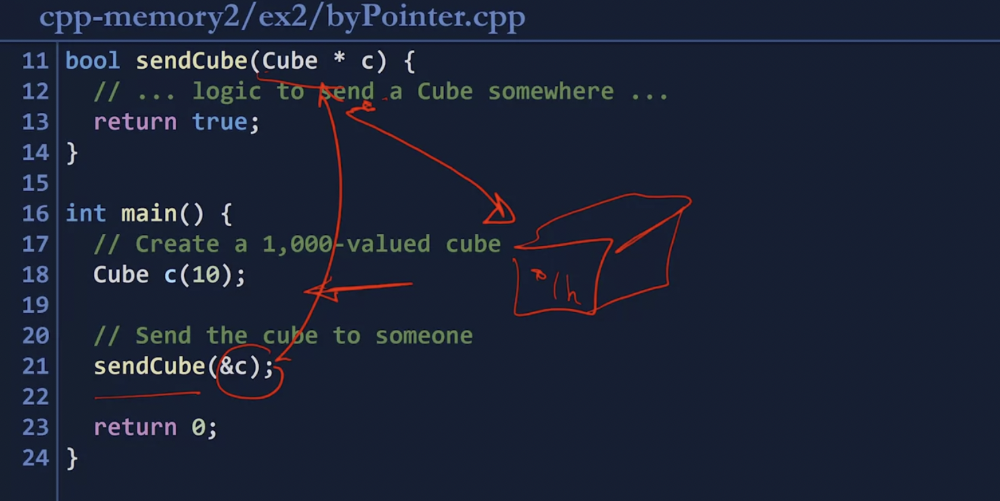

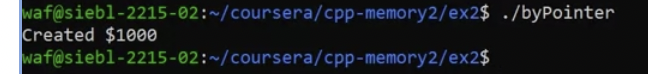

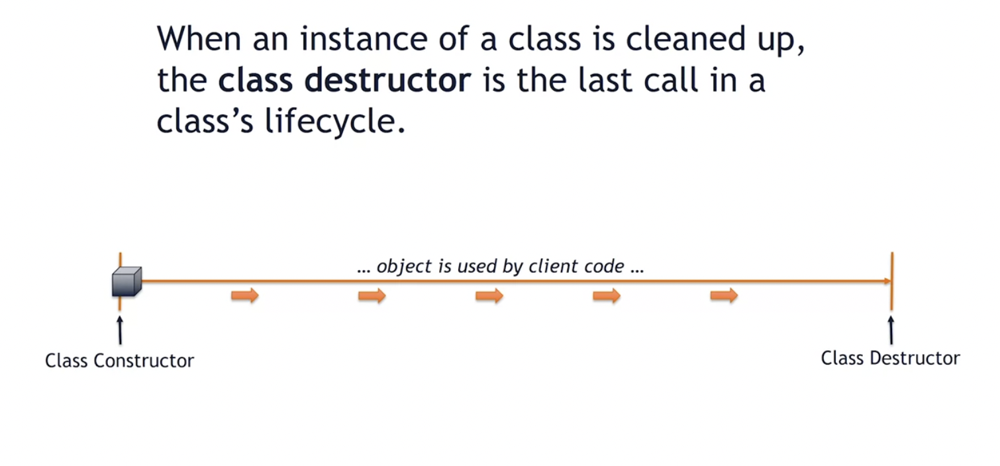

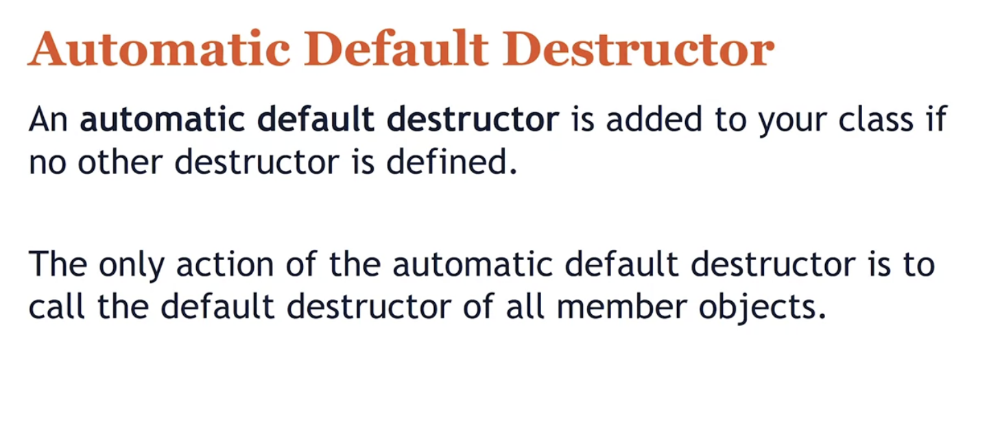

The destructors aren't called at compile time, but rather during runtime. The professor is pointing out that the compiler will insert implicit, automatic calls to the destructor in appropriate places where stack objects should be destroyed as they go out of scope, or where heap objects are destroyed with "delete". That's why you don't need to call the destructor explicitly.

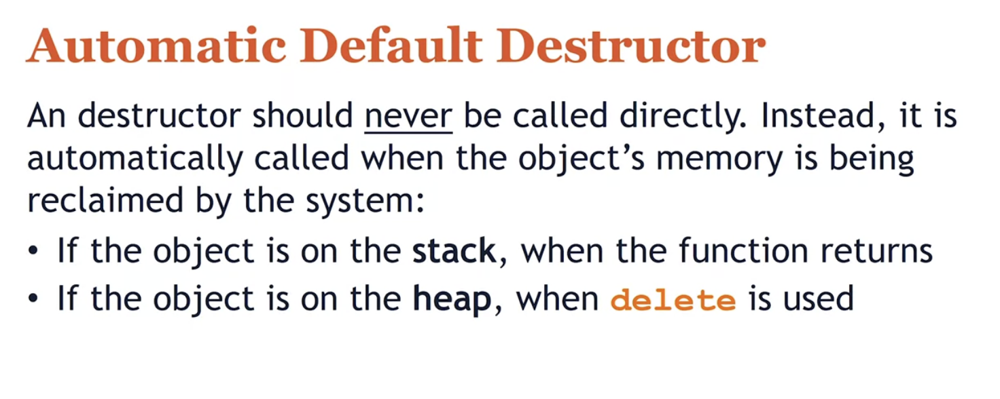

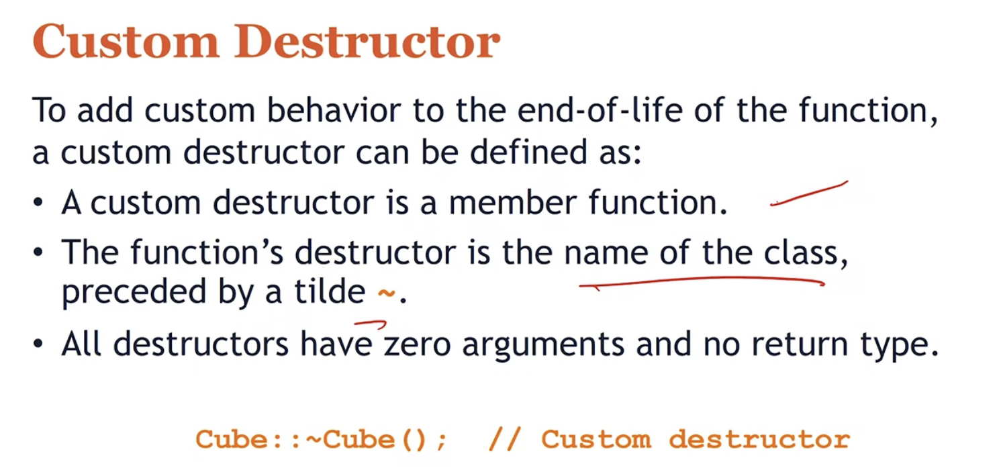

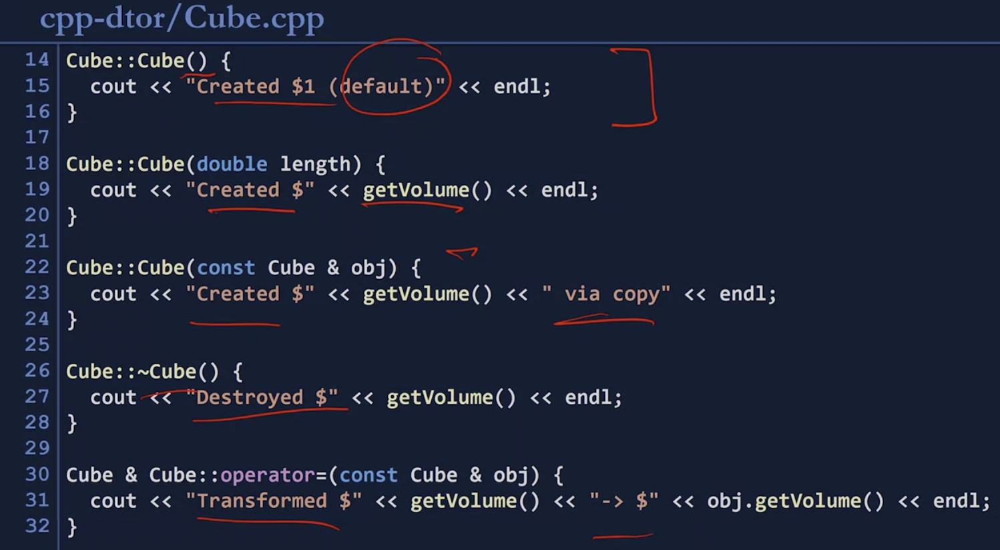

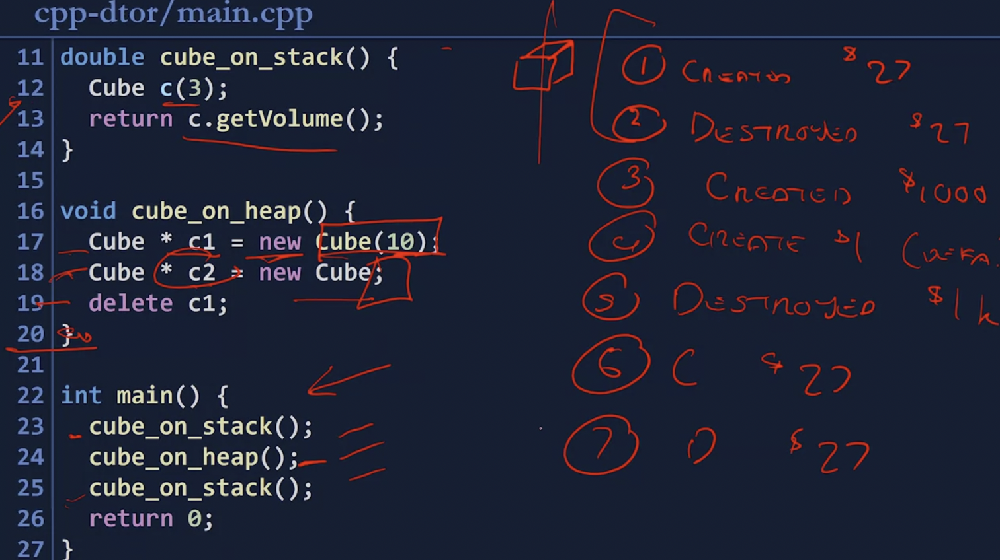

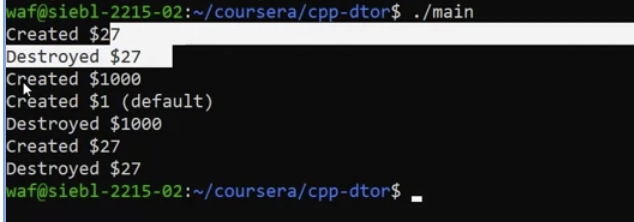

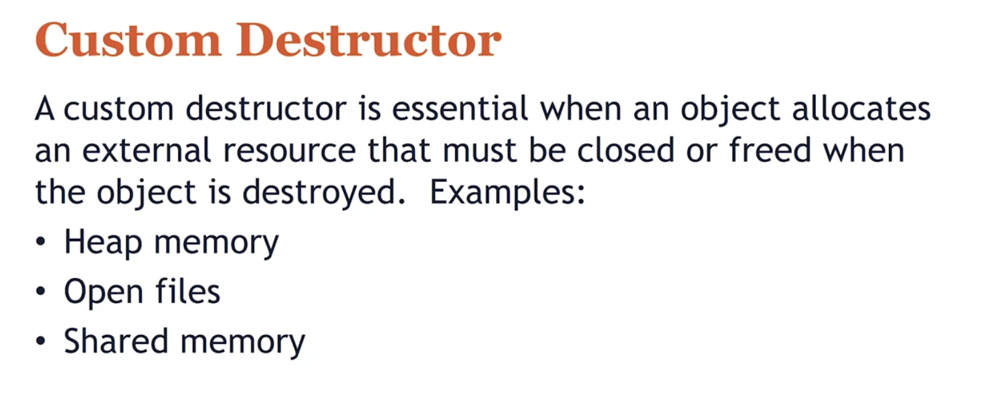

Various kinds of programming bugs related to pointers and memory can cause your program to crash. On Linux, if you dereference an address that you shouldn't, this is often called "segmentation fault," or "segfault." For example, if you dereference a pointer that is set to nullptr, it will almost certainly cause a segfault and crash immediately. This code will segfault:

In [ ]:
// This code compiles successfully, runs, and CRASHES with a segfault!
int* n = nullptr;
std::cout << *n << std::endl;

On other operating systems, the error message may say something different. Some C++ compilers may respond to this in other unpredictable ways, but this is one type of error that has a fairly reliable symptom. It is actually an example of what we talk about in the next paragraph.

**Undefined behavior**

Sometimes it's possible to write a program that compiles, but that is not really a safe or valid program. There are some improper ways to write C++ that are not strictly forbidden by the C++ standard, but the C++ standard doesn't define how compilers are supposed to handle those situations, so your compiler may generate a program that works, or not! This is called "undefined behavior." Many beginning programmers make the mistake of thinking that just because their program compiles and runs for them on their system, that it must be valid and safe code. This isn't true. "It works for me" isn't an excuse, so be sure to proofread your code, use safe practices, and avoid relying on undefined behavior.

Many times, undefined behavior is caused by the careless use of uninitialized variables. Let's talk about initialization.

**Initialization**

Initialization is specifying a value for a variable from the moment it is created. Remember that if you don't initialize a pointer, you really should not try to dereference it. If you dereference an uninitialized pointer, even just to read from it and not to write to it, you may cause your program to crash, or something else unexpected might happen later. Here are some examples.

**Examples with stack memory**

This pointer "x" is uninitialized. It contains a seemingly random memory address. (However, this is also not a good way to get a source of randomness, even for those situations where we want random numbers!) Dereferencing this pointer would cause undefined (unpredictable) behavior:

In [ ]:
// Dangerous; this can lead to careless mistakes and crashes!
int* x;

This pointer is explicitly initialized to nullptr. Dereferencing this pointer would cause the program to crash, immediately and predictably. (On Linux, this is often called a "segmentation fault," or "segfault.") As we'll discuss below, it's a good practice to set a pointer to nullptr if you aren't setting it to any other value immediately.

In [ ]:
// Explicitly initializing a pointer to nullptr
int* y = nullptr;

You can also initialize a value with the () syntax following the variable name. If the type is a class, the parameters will be given to the class type's corresponding constructor. For built-in types such as int, which are not class types, there are no constructors; however, we can still specify an initialization value this way. Sometimes you'll see initialization done with the {} syntax instead of (). This is a new feature since C++11. It can be a good way to make it clear that you are performing an initialization, not some kind of function call. Later in this course sequence, you'll see some other good ways to use the {} initialization syntax.

In [ ]:
// Other ways to initialize
int* y2(nullptr);
int* y3{nullptr};

Plain built-in types, such as int, that are not initialized will have unknown values. However, if you have a class type, its default constructor will be used to initialize the object. Here, int h has an unknown value, but supposing we have some well-defined class type Box, Box b will be given reasonable default values. (It's the responsibility of the Box class type to ensure that.)

In [ ]:
// h is uninitialized!
int h;
// b will be default initialized
Box b;

Here we create integer "i" on the stack, safely initialized with value 7, and then we create a pointer "z" on the stack, initialized to the address of i. This way, z points to i. It's safe to dereference z.

In [ ]:
int i = 7;
int* z = &i;

**Examples with heap memory**

When you want to use heap memory, you'll use the "new" operator. As with the stack memory case, you should be wary when you use "new" for a built-in type like int, since these types may not have default initialization. Therefore, you shouldn't assume they'll have an expected default value (such as 0). For those cases, be sure to initialize the value manually. Here are some examples.

The pointer "q" is created and initialized with the address for a newly-allocated integer on the heap. However, the integer that q points to does not have a predictable value. It depends on the compiler. We shouldn't rely on this integer to have any particular value at the beginning.

In [ ]:
int* q = new int;

You can specify initialization parameters at the end of the "new" expression. This will create pointer "r" initialized with newly-allocated memory for an integer with the value "0" explicitly.

In [ ]:
int* r = new int(0);

There are a lot of other special situations in C++ where different factors may slightly change how an object is initialized. You don't need to get into all those details. If you're unsure, the easiest thing to do is make sure that you explicitly initialize your variables. For a more exhaustive reference on initialization, you can refer to this page: https://en.cppreference.com/w/cpp/language/initialization

**Resetting deleted pointers to nullptr**

Now that we've reviewed initialization, especially for pointers, let's talk about why you should manually reset pointers to nullptr when you're done with them.

Note that using "delete" on a pointer frees the heap memory allocated at that address. However, deleting the pointer does not change the pointer value itself to "nullptr" automatically; you should do that yourself after using "delete", as a safety precaution. For example:

In [ ]:
// Allocate an integer on the heap:
int* x = new int;
// Now x holds some memory address to a valid integer.
// Do some kind of work with the integer.
// We'll just set that integer to 7:
*x = 7;
// Now delete the pointer to deallocate the heap memory:
delete x;
// This destroys the integer on the heap and frees the memory.
// But now x still holds the memory address!
// Set x to nullptr for safety:
x = nullptr;

The idea here is that by manually setting x to nullptr after "delete x", we help prevent two kinds of problems:

1. We don't want to delete the same allocated address more than once by mistake, which could cause errors. Using "delete" on nullptr does nothing, so this way, if we accidentally try to delete the same address twice, nothing further happens.

2. We must never dereference a pointer to deallocated memory. This could cause the program to crash with a segfault, exhibit strange behavior, or cause a security vulnerability. However, attempting to dereference a nullptr will almost always cause a segfault and terminate the program immediately. This is actually better than causing a silent security vulnerabilty or another problem that is harder to detect! Therefore, it makes sense to set the deleted pointer to nullptr, thus ensuring that if we dereference it carelessly, then it will cause a very obvious runtime error that we can fix.

You should also note that we only need to use delete and nullptr with pointers, of course. Variables in stack memory don't need to be manually deleted. Those are automatically deallocated when they go out of scope. (Please refer to the other reading lesson on scope.)

In summary, remember that if you use "new," you will also need to "delete," and after you delete, you should set to nullptr.

**Growing beyond pointers**

As you go further in your lessons on C++, at first you may be frustrated that the use pointers and raw memory is very tedious. However, class types can be designed handle all the new and delete operations for you, invisibly. As you create your own robust data structures, and as you use libraries such as the C++ Standard Template Library, you will find that you very rarely have to use "new" and "delete" anymore.

**C++ Syntax Notes: The Modern Range-Based "for" Loop
Modern Range-Based "for" Loops**

In recent versions of C++, there is a version of the for loop that automatically iterates over all of the things in a container. This is very useful when used with a standard library container, because you don't have to worry about trying to access memory outside of a safe range, for example: the loop will automatically begin and end in the right place.

**for ( temporary variable declaration : container ) { loop body }**

There's an important detail about the temporary variable. If you declare an ordinary temporary variable in the loop, it just gets a copy of the current loop item by value. Changes you make to that temporary copy won't affect the actual container!

In [ ]:
#include <iostream>
#include <vector>
int main() {
  
  // In the standard library, a std::vector is an array with automatic size.
  // Let's make a vector of ints and loop over the contents.
  // The syntax for std::vector<> is discussed further in the lecture on template types.
  
  std::vector<int> int_list;
  int_list.push_back(1);
  int_list.push_back(2);
  int_list.push_back(3);
  
  // Automatically loop over each item, one at a time:
  for (int x : int_list) {
    // This version of the loop makes a temporary copy of each
    // list item by value. Since x is a temporary copy,
    // any changes to x do not modify the actual container.
    x = 99;
  }
  
  for (int x : int_list) {
    std::cout << "This item has value: " << x << std::endl;
  }
  
  std::cout << "If that worked correctly, you never saw 99!" << std::endl;

  return 0;
}

This item has value: 1

This item has value: 2

This item has value: 3

If that worked correctly, you never saw 99!

If you make the temporary variable of a reference type, you can actually modify the current container item instead of just getting a copy. This modified example shows how:

In [ ]:
#include <iostream>
#include <vector>
int main() {
  
  std::vector<int> int_list;
  int_list.push_back(1);
  int_list.push_back(2);
  int_list.push_back(3);
  
  for (int& x : int_list) {
    // This version of the loop will modify each item directly, by reference!
    x = 99;
  }
  
  for (int x : int_list) {
    std::cout << "This item has value: " << x << std::endl;
  }
  
  std::cout << "Everything was replaced with 99!" << std::endl;

  return 0;
}

This item has value: 99

This item has value: 99

This item has value: 99

Everything was replaced with 99!

There are more advanced ways to use this, too. For example, if you are iterating over large objects in a container, then even if you don't want to modify the objects, you might want to use a reference to a constant as the loop variable type to avoid making a temporary copy of a large object, which could otherwise be slow.

In [ ]:
#include <iostream>
#include <vector>
int main() {
  
  std::vector<int> int_list;
  int_list.push_back(1);
  int_list.push_back(2);
  int_list.push_back(3);
  
  for (const int& x : int_list) {
    // This version uses references, so it doesn't make any temporary copies.
    // However, they are read-only, because they are marked const!
    std::cout << "This item has value: " << x << std::endl;
    // This line would cause an error:
    //x = 99;
  }

  return 0;
}

This item has value: 1

This item has value: 2

This item has value: 3

This will probably be very useful to you in the future if you continue to use advanced C++.

**Unsigned Integer Types: Be Careful (Updated Dec. 16)**

**What are unsigned integers?**

Sometimes you'll see another integer type in C++ code, "unsigned" integer, that cannot represent negative values. Instead, unsigned integers have an increased upper positive value range compared to signed integers of the same memory usage. (Signed integers devote a bit of memory just to be able to represent a negative sign.) Unsigned integers are sometimes used in special cases to make use of memory extremely efficiently; for example, a data storage format might use them in order to be more compact. But mixing unsigned and signed integers in your code can cause unexpected problems. Let's walk through a few examples with unsigned integers.

**Unsigned type syntax**

The normal "int" syntax creates a signed int by default. But, you could also write "signed int" or "signed" to get the same type:

In [ ]:
int a = 7;
// signed int a = 7;
// signed a = 7;

If you write "unsigned int" or "unsigned", you can create a variable with the unsigned integer type:

In [ ]:
unsigned int b = 8;
// unsigned b = 8;

**Issues with unsigned arithmetic**

Unsigned ints can't represent negative values. Instead, they sacrifice the ability to represent negative numbers in exchange for a higher upper positive limit to the value range that they can represent, using the same number of bits as the comparable signed integer. However, the underlying bit representation that unsigned integers use for these very large values is actually the same as the representation that signed integers use for their negative value range. This means that a negative signed int may be re-interpreted as a very large positive unsigned int, and vice versa. This can cause strange behavior if you mix signed and unsigned ints. If you do arithmetic between signed and unsigned ints, then you can get undesired results if negative values should logically have arisen.

**Issues with addition**

Addition with unsigned values may be no problem, as long as you don't exceed the maximum range. This is 7+8 and shows 15 as expected

In [ ]:
std::cout << (a+b) << std::endl;

However, you do need to be careful if you are approaching the upper limit for a signed int even if you are using unsigned ints. Signed ints have a lower maximum value, so if you get an unsigned int greater than that limit and then cast it to signed int, it will be interpreted as a negative number you did not expect.

**Issues with subtraction**

Now let's look at issues that can arise if you do subtraction with unsigned ints and try to imply negative values that can't be represented. We'll create some unsigned ints:


In [ ]:
unsigned int x = 10;
unsigned int y = 20;

Now writing (y-x) is 20-10 in unsigned arithmetic, which results in 10 as expected:

In [ ]:
std::cout << (y-x) << std::endl;

By contrast, the next example attempts (x-y) which is 10-20, but the unsigned arithmetic can't represent -10, and instead results in a very large positive value. The output is 4294967286, which is close to the maximum for an unsigned 32-bit integer.

In [ ]:
std::cout << (x-y) << std::endl;

**Casting values back to signed int**

If we explicitly cast the result back to a signed integer, then we might get something usable again. The output of this is -10:

In [ ]:
std::cout << (int)(x-y) << std::endl;

You can also do a casting operation to convert to signed int just by assigning an unsigned result to a signed int variable. This also outputs -10:

In [ ]:
int z = x - y;
std::cout << z << std::endl;

However, casting a result is not always the best way to handle this! Instead, you may want to create temporary working copies of unsigned values as signed types. That way, you can do operations as usual and manually check whether a value is negative or positive, in those cases where it should not be negative. For example, if you are assigning an unsigned int value to a signed int, you can check whether the signed int shows a negative value. If it is negative, that means the unsigned value was too large to be accurately cast to signed. Here's a contrived example:

In [ ]:
int test_val = (x-y);
if (test_val < 0) {
  // Note: The standard error stream (cerr) will be displayed in the terminal.
  // You can also handle it separately from the standard output stream (cout)
  // if you are logging things to files.
  std::cerr << "Warning: unsigned value cast to signed int resulted in a negative value" << std::endl;
}

Making direct comparisons between signed and unsigned ints can also cause issues. This next line may give a warning or error. We have commented it out for now:

In [ ]:
// std::cout << (a<b) << std::endl;

**Container sizes are often unsigned**

We often refer to a generic data structure class as a "container". The C++ Standard Template Library (STL) provides many of these, such as std::vector. Many of these class types have a size() member variable that returns the number of items the container currently holds. It's important to note that in many cases, this will give you the size in an unsigned integer type. (The exact byte size of the specific unsigned integer type may vary.) So, although you should probably try to avoid using unsigned integers in your code except in very special circumstances, you will run into cases where you are comparing a signed int (perhaps an iteration counter) with an unsigned integer size. So, be prepared to safely handle unsigned ints!

Here is an example where the compiler will warn you it's comparing the signed integer i with the unsigned integer returned by size():

In [ ]:
std::vector<int> v = {1,2,3,4};
for (int i=0; i < v.size(); i++) {
    std::cout << v[i] << std::endl;
}

You could handle this using various casting methods described above to make the warning message go away. You could simply use an unsigned int, or indeed std::vector<int>::size_type itself, as the type for the counter i. (However, this may cause you more trouble if you are doing common arithmetic operations on i for one reason or another, because again, you are introducing an unsigned integer to your code. Let's suppose for now that your containers won't need to contain an astronomical number of items.)

Now, consider the danger of trying to subtract from the unsigned int that represents the size. If we wrote the code in the following way, what could go wrong?

In [ ]:
std::vector<int> v = {1,2,3,4};
for (int i=0; i <= v.size()-1; i++) {
    std::cout << v[i] << std::endl;
}

This code seems to work as expected, but only because the size is nonzero. If we had any situation where this loop might process an empty vector, the program would crash:

In [ ]:
std::vector<int> v;
for (int i=0; i <= v.size()-1; i++) {
    std::cout << v[i] << std::endl;
}

Here, the vector v is initialized empty by default, so its size() is reported as 0. That means the expression "v.size()-1" will evaluate to -1 interpreted as an unsigned integer, in this case meaning a very large positive integer. So, on the first loop iteration, "0 <= (a very large positive integer)" will be evaluated as true, and the loop body will execute, evaluating v[0], even though there is no first item in v to access. As a result, this code will most likely cause a segfault and crash.

So, here, it is most reasonable to write it the "i < v.size()" way perhaps, but these other tricks would also solve this issue. Let's think about why:

In [ ]:
// Casting to signed int first helps to ensure that the result
// of subtraction will truly be a signed negative value when size is 0:
for (int i=0; i <= (int)v.size()-1; i++) {
    // ...
}

// Rewriting the algebra to perform addition instead of subtraction
// helps to avoid going below 0:
for (int i=0; i+1 <= v.size(); i++) {
    // ...
}

In practice, for this code to actually be fully robust, you'd also need to check i against the maximum limit for an integer of its type, and make sure that the container never grew that large either. However, these are separate concerns. For now, just be sure to observe when you are converting to or from an unsigned integer type, and watch out for the potential problems it can cause.

**Conclusion**

Be careful when you are dealing with unsigned integers! In general, you should only use unsigned integers when you absolutely need to, such as if you are trying to maximize the range of positive values you can store in the same amount of memory. For everyday high-level programming purposes, signed integers may be all you need. If you need to ensure positive values during your code execution, you can write safety checks into the code to monitor values and issue warnings or errors if a certain range is exceeded.